<a href="https://colab.research.google.com/github/changsin/FSDL/blob/main/kaggle_license_plate_clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup
The data came from:
https://www.kaggle.com/andrewmvd/car-plate-detection



This dataset contains 433 images with bounding box annotations of the car license plates within the image. Our goal here is to train a convolutional neural network capable of locating licenses plate on new images. 

## Mount the google drive

In [13]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Wegiths and Biases

In [169]:
!pip install wandb -qqq
import wandb
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [170]:
wandb.init(project="car_plate_probs",
           config={
               "batch_size": 32,
               "learning_rate": 0.01,
               "dataset": "Kaggle-Car-Plate",
           })

wandb: Currently logged in as: changsin (use `wandb login --relogin` to force relogin)


## Prepare the data

Import libraries

In [14]:
%matplotlib inline

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import cv2
import os
import glob

We display the files in Kaggle repertoire :

In [15]:
IMAGE_SIZE = 224
DATA_ROOT = "./drive/MyDrive/data/Kaggle_license_plates"

In [16]:
# import os
# for dirname, _, filenames in os.walk(DATA_ROOT):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [17]:
DATA_ROOT

'./drive/MyDrive/data/Kaggle_license_plates'

We create the variable X containing all the images of cars by resizing them.



In [18]:
img_dir = DATA_ROOT + "/images" # Enter Directory of all images 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)
files.sort() #We sort the images in alphabetical order to match them to the xml files containing the annotations of the bounding boxes
X_raw=[]
for f1 in files:
    img = cv2.imread(f1)
    img = cv2.resize(img, (IMAGE_SIZE,IMAGE_SIZE))
    X_raw.append(np.array(img))
    

We create the variable y containing all the bounding boxe annotations (label). 
Before that, we will have to resize the annotations so that it fits the new size of the images (200*200). We create a function resizeannotation for that. 

In [19]:
from lxml import etree
def resizeannotation(f):
    tree = etree.parse(f)
    for dim in tree.xpath("size"):
        width = int(dim.xpath("width")[0].text)
        height = int(dim.xpath("height")[0].text)
    for dim in tree.xpath("object/bndbox"):
        xmin = int(dim.xpath("xmin")[0].text)/(width/IMAGE_SIZE)
        ymin = int(dim.xpath("ymin")[0].text)/(height/IMAGE_SIZE)
        xmax = int(dim.xpath("xmax")[0].text)/(width/IMAGE_SIZE)
        ymax = int(dim.xpath("ymax")[0].text)/(height/IMAGE_SIZE)
    return [int(xmin), int(ymin), int(xmax), int(ymax)]
        

In [20]:

label_dir = DATA_ROOT + "/annotations"
text_files = [DATA_ROOT + '/annotations/'+f for f in sorted(os.listdir(label_dir))]

y_raw=[]
for f in text_files:
    # print(f)
    y_raw.append(resizeannotation(f))

In [21]:
def print_file(text_file):
  with open(text_file, "r") as file:
    for line in file:
      print(line)

We check X and y shape

In [22]:
print(np.array(X_raw).shape)
print(np.array(y_raw).shape)

(433, 224, 224, 3)
(433, 4)


In [23]:
def noise_annotation(y, scale):
  y_noise = []
  for y1 in y:
    y1_noise = []
    for e in y1:
      y1_noise.append(int(np.random.normal(loc=e, scale=scale, size=1)))
    y_noise.append(y1_noise)
  return y_noise

# print("original: ", y_raw[0])
# y_noise = noise_annotation(y_raw, 5)
# print("with noise: ", y_noise[0])

And we display the first eighteen image of the dataset : 

In [24]:
import matplotlib.patches as patches

def create_rect(y, color):
  width = y[2] - y[0]
  height = y[3] - y[1]
  return patches.Rectangle((y[0], y[1]),
                            width, height,
                            edgecolor=color, fill=False)



# Run clustering on the data

The Elbow method found 11 to be optimal clusters, but given the small number of data, we can choose a smaller number of clusters for the experiments.

Ideally, we want to:

1. Ensure that we have the same distributions for train, validation and test datasets.
2. Pick uniformally across various dataset clusters.
3. Observe any discrepancies across clusters.
4. Find the minimum set of training sets for optimal performance.


## Plot annotation boxes

In [13]:
def plot_with_boxes(X, y1, y2):
  fig = plt.figure(figsize=(20,40))
  for i in range(0,10) :
      axis = fig.add_subplot(10, 5, i+1)
      plt.axis('off')
      image = X[i]

      rect_ori = create_rect(y1[i], (0, 255/255, 0))
      rect_noise = create_rect(y2[i], (255/255, 0, 0))
      axis.add_patch(rect_ori)
      axis.add_patch(rect_noise)

      # Don't use this method as this leaves the annotations in the images
      # image = cv2.rectangle(X[i],
      #                       (y[i][0], y[i][1]),
      #                       (y[i][2], y[i][3]),
      #                       (0, 255, 0))
      # image = cv2.rectangle(image,
      #                       (y_noise[i][0], y_noise[i][1]),
      #                       (y_noise[i][2], y_noise[i][3]),
      #                       (255, 0, 0))
      plt.imshow(image)

# plot_with_boxes(X_raw, y_raw, y_noise)

## Transform & normalize data

In [14]:
#Transforming in array
X = np.array(X_raw)
y = np.array(y_raw)

In [15]:
#Renormalisation
X = X / IMAGE_SIZE
y = y / IMAGE_SIZE

In [16]:
X.shape

(433, 224, 224, 3)

We split our dataset in two : training set/testing set

In [17]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=1)

### Import libraries

In [18]:
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.applications.vgg16 import VGG16
import tensorflow as tf
import tensorflow_probability as tfp
dist = tfp.distributions

# Models

### Create CNN Model

In [51]:
# Create the model
def create_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(Dense(128, activation="relu"))
  model.add(Dense(128, activation="relu"))
  model.add(Dense(64, activation="relu"))
  model.add(Dense(4, activation="sigmoid"))

  model.layers[-6].trainable = False
  model.summary()

  return model

In [52]:
y_train.shape[0]

311

### Create Probability Model

In [167]:
kl_divergence_fn = lambda q, p, _: dist.kl_divergence(q, p) / tf.cast(y_train.shape[0], dtype=tf.float32)

# Create the model
def create_prob_model():
  model = Sequential()
  model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(Flatten())
  model.add(Dense(128, activation="relu"))
  model.add(Dense(128, activation="relu"))
  model.add(Dense(64, activation="relu"))
  model.add(tfp.layers.DenseFlipout(4, activation="sigmoid", kernel_divergence_fn=kl_divergence_fn))

  model.layers[-6].trainable = False
  model.summary()

  return model

# Metrics

In [19]:
#GT Boxes
gt_boxes= {"img_00285.png": [[480, 457, 515, 529], [637, 435, 676, 536]]}
#Pred Boxes
pred_boxes={"img_00285.png": {"boxes":
                             [[330, 463, 387, 505],
                              [356, 456, 391, 521],
                              [420, 433, 451, 498],
                              [468, 435, 520, 521]],
                              "scores": [0.0739, 0.0843, 0.091, 0.1008]}}

def create_gt_boxes(X_test):
  gt_boxes = dict()
  for id in range(len(X_test)):
    gt_boxes[str(id)] = [list(X_test[id].tolist())]
  return gt_boxes

def create_pred_boxes(y_preds, scores):
  pred_boxes = dict()
  for id in range(len(y_preds)):
    pred_boxes[str(id)] =  {
        "boxes": [y_preds[id].tolist()],
        "scores": list(scores[id])
    }
  return pred_boxes

In [20]:
def get_model_scores(pred_boxes):
    """Creates a dictionary of from model_scores to image ids.
    Args:
        pred_boxes (dict): dict of dicts of 'boxes' and 'scores'
    Returns:
        dict: keys are model_scores and values are image ids (usually filenames)
    """
    model_score={}
    for img_id, val in pred_boxes.items():
        for score in val['scores']:
            if score not in model_score.keys():
                model_score[score]=[img_id]
            else:
                model_score[score].append(img_id)
    return model_score

## IOU

In [21]:
# https://towardsdatascience.com/evaluating-performance-of-an-object-detection-model-137a349c517b
def calc_iou(gt_bbox, pred_bbox):
    '''
    This function takes the predicted bounding box and ground truth bounding box and 
    return the IoU ratio
    '''
    x_topleft_gt, y_topleft_gt, x_bottomright_gt, y_bottomright_gt = gt_bbox
    x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = pred_bbox
    
    if (x_topleft_gt > x_bottomright_gt) or (y_topleft_gt > y_bottomright_gt):
        raise AssertionError("Ground Truth Bounding Box is not correct")
    if (x_topleft_p > x_bottomright_p) or (y_topleft_p > y_bottomright_p):
        raise AssertionError("Predicted Bounding Box is not correct",
                             x_topleft_p, x_bottomright_p, y_topleft_p, y_bottomright_gt)
        
         
    #if the GT bbox and predcited BBox do not overlap then iou=0
    if(x_bottomright_gt< x_topleft_p):
        # If bottom right of x-coordinate  GT  bbox is less than or above the top left of x coordinate of  the predicted BBox
        return 0.0

    if(y_bottomright_gt< y_topleft_p):  # If bottom right of y-coordinate  GT  bbox is less than or above the top left of y coordinate of  the predicted BBox
        return 0.0
    if(x_topleft_gt> x_bottomright_p): # If bottom right of x-coordinate  GT  bbox is greater than or below the bottom right  of x coordinate of  the predcited BBox
        return 0.0

    if(y_topleft_gt> y_bottomright_p): # If bottom right of y-coordinate  GT  bbox is greater than or below the bottom right  of y coordinate of  the predcited BBox
        return 0.0
    
    GT_bbox_area = (x_bottomright_gt - x_topleft_gt + 1) * (y_bottomright_gt - y_topleft_gt + 1)
    Pred_bbox_area =(x_bottomright_p - x_topleft_p + 1) * (y_bottomright_p - y_topleft_p + 1)
    
    x_top_left =np.max([x_topleft_gt, x_topleft_p])
    y_top_left = np.max([y_topleft_gt, y_topleft_p])
    x_bottom_right = np.min([x_bottomright_gt, x_bottomright_p])
    y_bottom_right = np.min([y_bottomright_gt, y_bottomright_p])
    
    intersection_area = (x_bottom_right- x_top_left + 1) * (y_bottom_right-y_top_left  + 1)
    
    union_area = (GT_bbox_area + Pred_bbox_area - intersection_area)
   
    return intersection_area/union_area

In [22]:
def calc_precision_recall(image_results):
    """Calculates precision and recall from the set of images
    Args:
        img_results (dict): dictionary formatted like:
            {
                'img_id1': {'true_pos': int, 'false_pos': int, 'false_neg': int},
                'img_id2': ...
                ...
            }
    Returns:
        tuple: of floats of (precision, recall)
    """
    true_positive=0
    false_positive=0
    false_negative=0
    for img_id, res in image_results.items():
        true_positive +=res['true_positive']
        false_positive += res['false_positive']
        false_negative += res['false_negative']
        try:
            precision = true_positive/(true_positive+ false_positive)
        except ZeroDivisionError:
            precision=0.0
        try:
            recall = true_positive/(true_positive + false_negative)
        except ZeroDivisionError:
            recall=0.0
    return (precision, recall)

In [23]:
def get_single_image_results(gt_boxes, pred_boxes, iou_thr):
    """Calculates number of true_pos, false_pos, false_neg from single batch of boxes.
    Args:
        gt_boxes (list of list of floats): list of locations of ground truth
            objects as [xmin, ymin, xmax, ymax]
        pred_boxes (dict): dict of dicts of 'boxes' (formatted like `gt_boxes`)
            and 'scores'
        iou_thr (float): value of IoU to consider as threshold for a
            true prediction.
    Returns:
        dict: true positives (int), false positives (int), false negatives (int)
    """
    all_pred_indices= range(len(pred_boxes))
    all_gt_indices=range(len(gt_boxes))
    if len(all_pred_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    if len(all_gt_indices)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    
    gt_idx_thr=[]
    pred_idx_thr=[]
    ious=[]
    for ipb, pred_box in enumerate(pred_boxes):
        for igb, gt_box in enumerate(gt_boxes):
            iou= calc_iou(gt_box, pred_box)
            
            if iou >iou_thr:
                gt_idx_thr.append(igb)
                pred_idx_thr.append(ipb)
                ious.append(iou)
    iou_sort = np.argsort(ious)[::1]
    if len(iou_sort)==0:
        tp=0
        fp=0
        fn=0
        return {'true_positive':tp, 'false_positive':fp, 'false_negative':fn}
    else:
        gt_match_idx=[]
        pred_match_idx=[]
        for idx in iou_sort:
            gt_idx=gt_idx_thr[idx]
            pr_idx= pred_idx_thr[idx]
            # If the boxes are unmatched, add them to matches
            if(gt_idx not in gt_match_idx) and (pr_idx not in pred_match_idx):
                gt_match_idx.append(gt_idx)
                pred_match_idx.append(pr_idx)
        tp= len(gt_match_idx)
        fp= len(pred_boxes) - len(pred_match_idx)
        fn = len(gt_boxes) - len(gt_match_idx)
    return {'true_positive': tp, 'false_positive': fp, 'false_negative': fn}

In [24]:
from copy import deepcopy
def  get_avg_precision_at_iou(gt_boxes, pred_bb, iou_thr=0.5):
    model_scores = get_model_scores(pred_bb)
    sorted_model_scores= sorted(model_scores.keys())
# Sort the predicted boxes in descending order (lowest scoring boxes first):
    for img_id in pred_bb.keys():
        
        arg_sort = np.argsort(pred_bb[img_id]['scores'])
        pred_bb[img_id]['scores'] = np.array(pred_bb[img_id]['scores'])[arg_sort].tolist()
        pred_bb[img_id]['boxes'] = np.array(pred_bb[img_id]['boxes'])[arg_sort].tolist()

    pred_boxes_pruned = deepcopy(pred_bb)
    
    precisions = []
    recalls = []
    model_thrs = []
    img_results = {}
# Loop over model score thresholds and calculate precision, recall
    for ithr, model_score_thr in enumerate(sorted_model_scores[:-1]):
            # On first iteration, define img_results for the first time:
        # print("Mode score : ", model_score_thr)
        img_ids = gt_boxes.keys() if ithr == 0 else model_scores[model_score_thr]
    
        for img_id in img_ids:
            gt_boxes_img = gt_boxes[img_id]
            box_scores = pred_boxes_pruned[img_id]['scores']
            start_idx = 0
            for score in box_scores:
                if score <= model_score_thr:
                    pred_boxes_pruned[img_id]
                    start_idx += 1
                else:
                    break 
            # Remove boxes, scores of lower than threshold scores:
            pred_boxes_pruned[img_id]['scores']= pred_boxes_pruned[img_id]['scores'][start_idx:]
            pred_boxes_pruned[img_id]['boxes']= pred_boxes_pruned[img_id]['boxes'][start_idx:]
# Recalculate image results for this image
            # print(img_id)
            img_results[img_id] = get_single_image_results(gt_boxes_img,
                                      pred_boxes_pruned[img_id]['boxes'],
                                      iou_thr=0.5)
# calculate precision and recall
        prec, rec = calc_precision_recall(img_results)
        precisions.append(prec)
        recalls.append(rec)
        model_thrs.append(model_score_thr)

    precisions = np.array(precisions)
    recalls = np.array(recalls)

    prec_at_rec = []
    for recall_level in np.linspace(0.0, 1.0, 11):
        try:
            args= np.argwhere(recalls>recall_level).flatten()
            prec= max(precisions[args])
            # print(recalls,"Recall")
            # print(      recall_level,"Recall Level")
            # print(       args, "Args")
            # print(       prec, "precision")
        except ValueError:
            prec=0.0
        prec_at_rec.append(prec)
    avg_prec = np.mean(prec_at_rec) 
    return {
        'avg_prec': avg_prec,
        'precisions': precisions,
        'recalls': recalls,
        'model_thrs': model_thrs}

In [25]:
# this method is borrowed from
# https://www.pyimagesearch.com/2016/11/07/intersection-over-union-iou-for-object-detection/
def bb_iou(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    # print("xA:{} yA:{} xB:{} yB:{}".format(xA, yA, xB, yB))
    # print("xB - xA + 1:{} yB - yA + 1:{}".format(xB - xA + 1, yB - yA + 1))

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    # print("interArea:{}".format(interArea))

    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    # print("boxAArea:{} boxBArea:{}".format(boxAArea, boxBArea))

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)
    # return the intersection over union value
    return iou

# This also works, but does not quite work in some cases
# https://medium.com/koderunners/intersection-over-union-516a3950269c
def bb_iou2(box1, box2):
    x1, y1, x12, y12 = box1
    x2, y2, x22, y22 = box2
    w1 = x1 - x12
    h1 = y1 - y12
    w2 = x2 - x22
    h2 = y2 - y22
    w_intersection = min(x1 + w1, x2 + w2) - max(x1, x2)
    h_intersection = min(y1 + h1, y2 + h2) - max(y1, y2)
    if w_intersection <= 0 or h_intersection <= 0: # No overlap
        return 0
    I = w_intersection * h_intersection
    U = w1 * h1 + w2 * h2 - I # Union = Total Area - I
    return I / U

## Calculate mAP

In [26]:
def calculate_map(y_test, y_preds, threshold=0.5):
  y_test_scaled = y_test*IMAGE_SIZE
  y_pred_scaled = y_preds*IMAGE_SIZE
  scores = [[calc_iou(y_test_scaled[id], y_pred_scaled[id])] for id in range(len(y_test_scaled))]

  gt_boxes = create_gt_boxes(y_test_scaled)
  pred_boxes = create_pred_boxes(y_pred_scaled, scores)

  map = get_avg_precision_at_iou(gt_boxes=gt_boxes, pred_bb=pred_boxes)
  print("mAP:{:.2}".format(map['avg_prec']))
  return map

# Setup experiment

In [172]:
def plot_predictions(X_test, y_test, y_pred):
  fig = plt.figure(figsize=(20,40))

  for i in range(0, 10) :
    axis = fig.add_subplot(10, 5, i+1)
    plt.subplot(10,5,i+1)
    plt.axis('off')

    image = X_test[i]

    y_pred1 = y_pred[i]*IMAGE_SIZE
    y_pred1 = int(y_pred1[0]), int(y_pred1[1]), int(y_pred1[2]), int(y_pred1[3])

    y_gt1 = y_test[i]*IMAGE_SIZE
    y_gt1 = int(y_gt1[0]), int(y_gt1[1]), int(y_gt1[2]), int(y_gt1[3])

    rect_ori = create_rect(y_gt1, (0, 255/255, 0))
    rect_pred = create_rect(y_pred1, (255/255, 0, 0))
    axis.add_patch(rect_ori)
    axis.add_patch(rect_pred)

    iou = bb_iou(y_pred1, y_gt1)
    iou2 = bb_iou2(y_pred1, y_gt1)

    plt.title("IOU: {:0.2f} IOU2:{:0.2f}".format(iou, iou2))
    plt.imshow(image)

In [173]:
def fix_predictions(y_preds):
  for id in range(len(y_preds)):
    x_topleft_p, y_topleft_p, x_bottomright_p, y_bottomright_p = y_preds[id]
    if x_topleft_p > x_bottomright_p:
      y_preds[id][0] = x_bottomright_p
      y_preds[id][2] = x_topleft_p
    if y_topleft_p > y_bottomright_p:
      y_preds[id][1] = y_bottomright_p
      y_preds[id][3] = y_topleft_p
  return y_preds

In [174]:
def run_experiment(model,
                   X_train, y_train,
                   X_val, y_val,
                   X_test, y_test,
                   epochs, batch_size):

  model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])

  train_history = model.fit(x=X_train, y=y_train,
                            validation_data=(X_val, y_val),
                            epochs=epochs, batch_size=batch_size, verbose=1,
                            callbacks=[wandb.keras.WandbCallback(data_type="image",
                            save_model=False)])
  # Test
  scores = model.evaluate(X_test, y_test, verbose=0)
  print("Score : %.2f%%" % (scores[1]*100))

  test_loss, test_accuracy = model.evaluate(X_test, y_test, steps=int(100))

  print("Test results \n Loss:",test_loss,'\n Accuracy',test_accuracy)

  y_preds = model.predict(X_test)

  # TODO:
  # Hack to fix erroneous predictions
  y_preds = fix_predictions(y_preds)

  plot_predictions(X_test, y_test, y_preds)
  map = calculate_map(y_test, y_preds)
  return model, y_preds, map

# K Means Clustering
Run k means clustering against the dataset.

In [27]:
from scipy import ndimage
i0 = ndimage.distance_transform_edt(X[0])
i1 = ndimage.distance_transform_edt(X[1])

In [77]:
from scipy.spatial import distance
distance.euclidean(X[0].flatten(), X[1].flatten())

145.60615044808358

In [86]:
distance.euclidean(X[1].flatten(), X[4].flatten())

138.97856300798804

In [88]:
X_t = X.reshape(len(X),-1)
X_t.shape

(433, 150528)

In [49]:
def plot_images(X, y, start, end):
  fig = plt.figure(figsize=(20,40))
  id = 0
  for i in [start, end]:
      axis = fig.add_subplot(10, 5, id+1)
      id += 1
      plt.axis('off')
      image = X[i]*IMAGE_SIZE

      rect_ori = create_rect(y[i]*IMAGE_SIZE, (0, 255/255, 0))
      axis.add_patch(rect_ori)
      plt.imshow(image)


In [79]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=11, random_state=0).fit(X.reshape(len(X),-1))

In [80]:
kmeans.labels_

array([ 3,  3,  6, 10,  6,  9,  1,  3,  6,  3,  2,  3,  9,  3, 10,  3,  3,
        9, 10,  2,  6,  2,  2, 10,  3,  3,  9,  3, 10,  1, 10,  9,  1,  4,
        6,  9,  1, 10, 10,  9, 10,  2, 10,  1,  9,  1,  3,  3,  2,  2,  2,
        3,  3, 10,  3,  3,  1,  1, 10,  4,  6,  2,  2, 10,  1, 10,  4,  5,
       10,  5,  2,  3,  5,  3,  1,  3,  6,  6,  1,  9, 10,  9,  9,  9, 10,
        3, 10,  3, 10,  6,  2,  9, 10,  3,  6,  4, 10,  2,  3,  2,  3,  6,
       10,  3,  6,  3, 10,  0,  1,  5,  3,  6, 10,  6,  3,  5,  9,  9,  1,
        3, 10,  4,  3,  1,  6,  6,  6,  3,  6,  2,  9,  6,  6, 10,  9,  3,
        1,  4,  2,  9,  9,  2, 10, 10, 10,  0,  3,  5, 10,  3,  0,  0,  3,
        6, 10,  7,  6,  6,  3,  8, 10,  9,  9,  1,  2,  6,  9,  3,  1,  3,
       10,  2, 10,  3,  3,  9, 10, 10,  3,  2, 10,  6,  1,  4,  2,  2,  9,
        3,  9, 10,  9, 10,  6,  4,  6,  3,  3,  9,  6,  6,  8,  3,  1,  0,
        9,  9,  2,  1, 10,  5,  3,  3,  3,  4, 10,  3, 10,  3, 10,  3,  0,
        2,  2,  9,  6,  2

In [100]:
group_ids, counts = np.unique(kmeans.labels_, return_counts=True)

In [101]:
print(group_ids, counts)

[ 0  1  2  3  4  5  6  7  8  9 10] [ 10  46  47 106  20  11  52   3   6  47  85]


<BarContainer object of 11 artists>

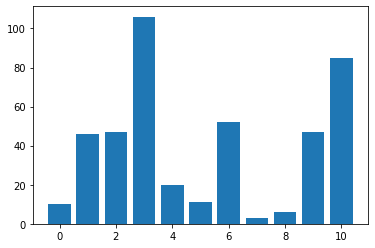

In [102]:
plt.bar(group_ids, counts)

In [92]:
len(kmeans.labels_[kmeans.labels_ == 3])

106

In [99]:
a = np.array([1, 2, 3, 4, 5])
a > 3

np.where(a > 3)[0]

array([3, 4])

In [103]:
def to_groups(group_ids, data):
  groups = []
  for group_id in group_ids:
    groups.append(np.where(data == group_id)[0])
  return groups

groups = to_groups(group_ids, kmeans.labels_)
groups

[array([107, 145, 150, 151, 203, 220, 255, 382, 387, 414]),
 array([  6,  29,  32,  36,  43,  45,  56,  57,  64,  74,  78, 108, 118,
        123, 136, 163, 168, 182, 202, 207, 230, 234, 242, 266, 269, 277,
        303, 304, 306, 309, 313, 317, 323, 329, 338, 339, 343, 357, 359,
        381, 388, 392, 399, 408, 418, 423]),
 array([ 10,  19,  21,  22,  41,  48,  49,  50,  61,  62,  70,  90,  97,
         99, 129, 138, 141, 164, 171, 179, 184, 185, 206, 221, 222, 225,
        247, 270, 276, 281, 297, 319, 322, 327, 335, 344, 351, 352, 368,
        370, 372, 378, 385, 395, 420, 431, 432]),
 array([  0,   1,   7,   9,  11,  13,  15,  16,  24,  25,  27,  46,  47,
         51,  52,  54,  55,  71,  73,  75,  85,  87,  93,  98, 100, 103,
        105, 110, 114, 119, 122, 127, 135, 146, 149, 152, 158, 167, 169,
        173, 174, 178, 187, 195, 196, 201, 210, 211, 212, 215, 217, 219,
        229, 236, 241, 244, 246, 248, 249, 251, 254, 256, 261, 262, 263,
        271, 272, 275, 279, 283, 285, 286,

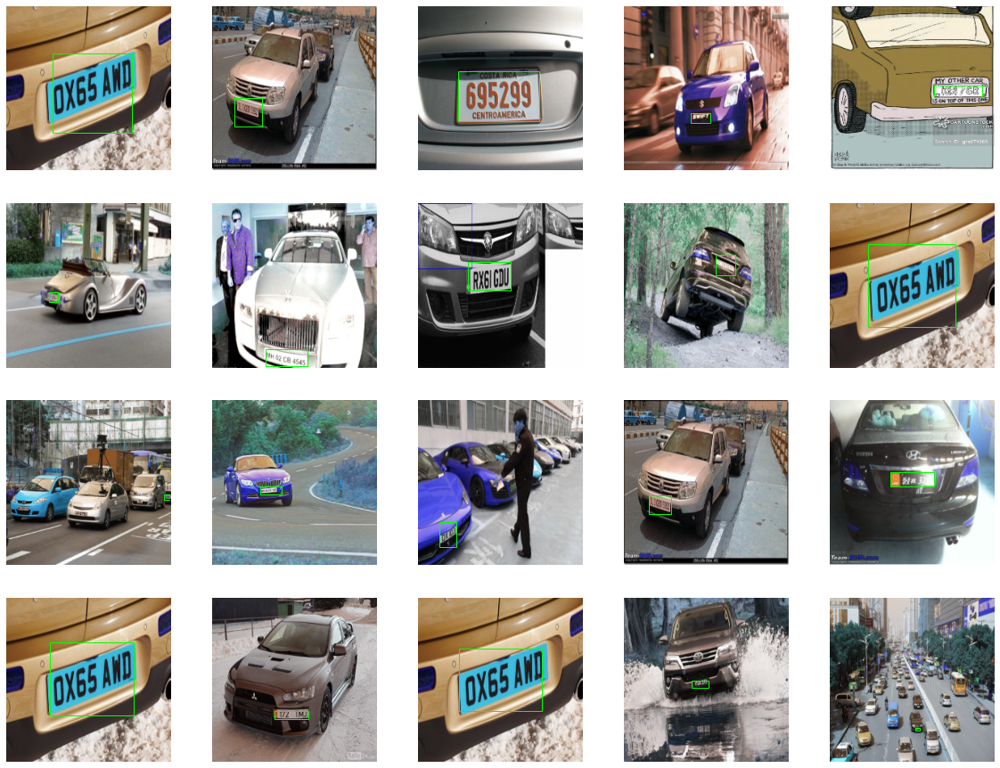

In [109]:
plot_images(X, y, groups[4])

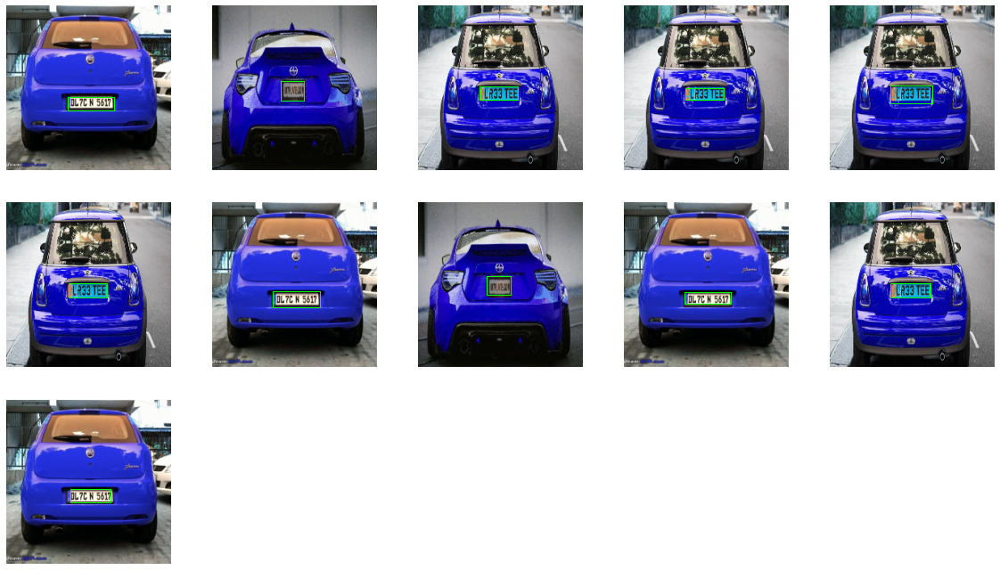

In [108]:
plot_images(X, y, groups[5])

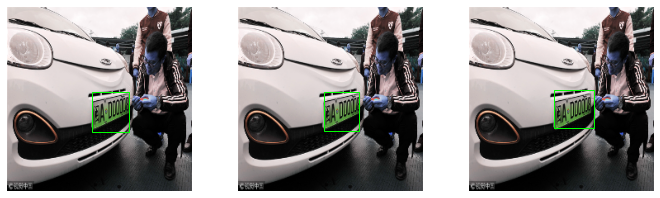

In [106]:
plot_images(X, y, groups[7])

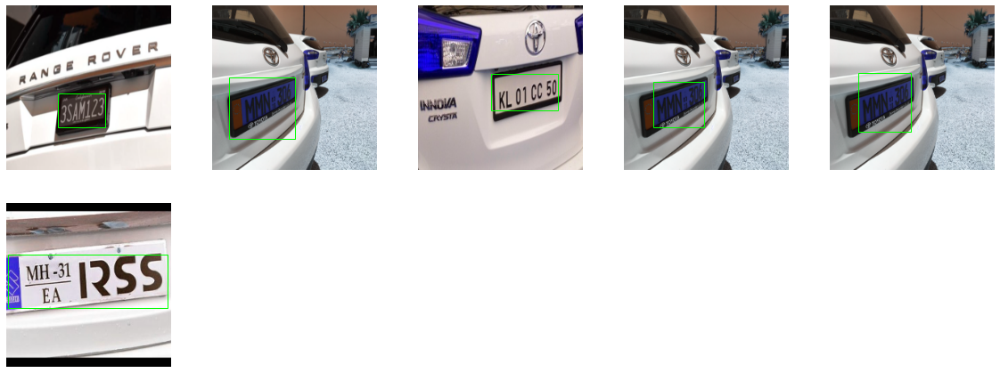

In [107]:
plot_images(X, y, groups[8])

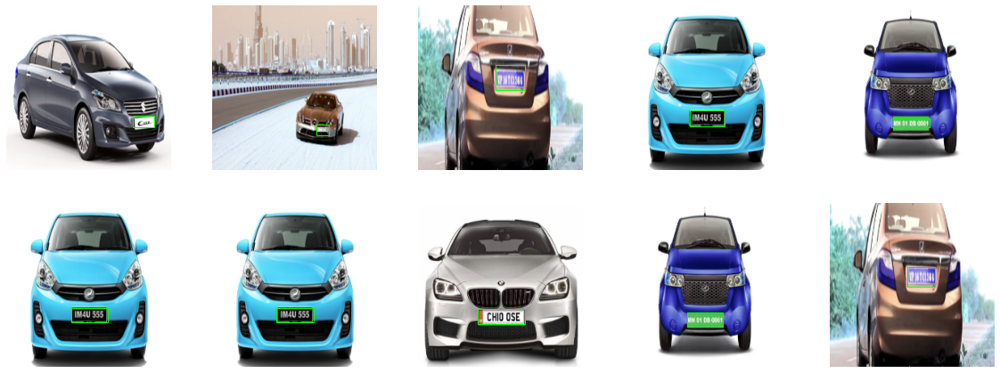

In [105]:
plot_images(X, y, groups[0])

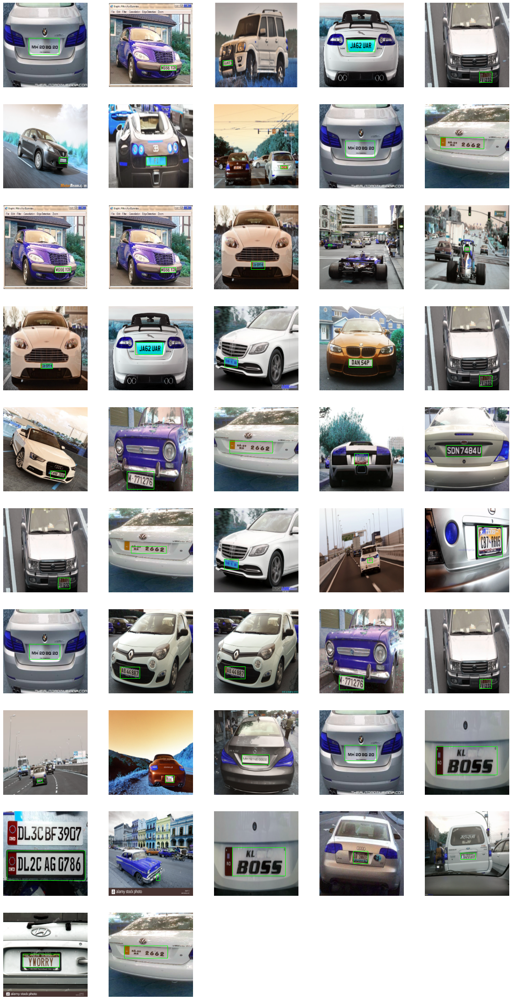

In [104]:
plot_images(X, y, groups[2])

In [52]:
import scipy
scipy.ndimage.find_objects(kmeans.labels_)

[(slice(6, 424, None),),
 (slice(10, 433, None),),
 (slice(0, 430, None),),
 (slice(33, 407, None),),
 (slice(67, 404, None),),
 (slice(2, 428, None),),
 (slice(155, 429, None),),
 (slice(159, 408, None),),
 (slice(5, 431, None),),
 (slice(3, 427, None),)]

In [83]:
ids = [id for id in range(len(kmeans.labels_))]

In [94]:
nn = np.vstack([ids, kmeans.labels_])

In [100]:
tt = np.array([ [id, nn[1][id]] for id in nn[0, :]])
tt.shape

(433, 2)

In [113]:
import pandas as pd

df = pd.DataFrame(tt)
g = df.groupby(by = 1)
g[0]

In [96]:
nn[0, :]

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [ ]:
[for id in nn]

In [86]:
nn.shape


(2, 433)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


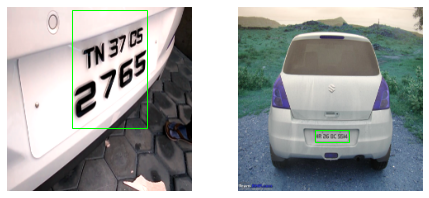

In [42]:
plot_images(X, y, 2, 4)

In [112]:
X[0].reshape((-1,3)).shape

(50176, 3)

## Elbow method to find the optimal k
Adapted from https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/

In [32]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist

def find_k(X):
  distortions = []
  inertias = []
  mapping1 = {}
  mapping2 = {}
  K = range(10, 15)
  
  for k in K:
      # Building and fitting the model
      kmeanModel = KMeans(n_clusters=k).fit(X)
      kmeanModel.fit(X)
  
      distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                          'euclidean'), axis=1)) / X.shape[0])
      inertias.append(kmeanModel.inertia_)
  
      mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                    'euclidean'), axis=1)) / X.shape[0]
      mapping2[k] = kmeanModel.inertia_
  
  return mapping1, mapping2, K, inertias, distortions

In [33]:
mapping1, mapping2, K, inertias, distortions = find_k(X.reshape(len(X),-1))


In [34]:
print("Elbow", mapping1)
print("mapping2", mapping2)

Elbow {10: 104.03249749637331, 11: 103.10312352976362, 12: 101.6067859189693, 13: 102.26749001212667, 14: 100.82706764423298}
mapping2 {10: 4814616.603107566, 11: 4737997.623679198, 12: 4730363.9842358045, 13: 4692806.712752489, 14: 4614212.104605412}


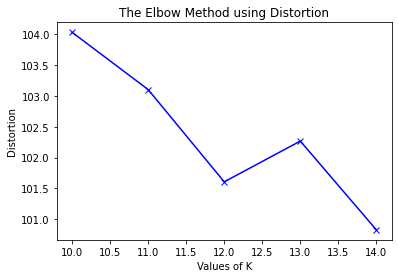

In [35]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

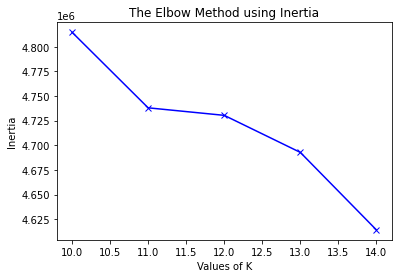

In [36]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

In [120]:
print("Elbow", mapping1)
print("mapping2", mapping2)

Elbow {1: 118.65955508616773, 2: 113.81741081301242, 3: 111.26931868426922, 4: 109.70504486918631, 5: 108.31961934906504, 6: 106.71785439442587, 7: 106.50219922318706, 8: 105.88184793285964, 9: 104.80005702139059}
mapping2 {1: 6303128.430595257, 2: 5779384.955971925, 3: 5502443.576369301, 4: 5340225.755338131, 5: 5208051.614096547, 6: 5058304.076693946, 7: 5027380.558469234, 8: 4969258.944017529, 9: 4874786.498505189}


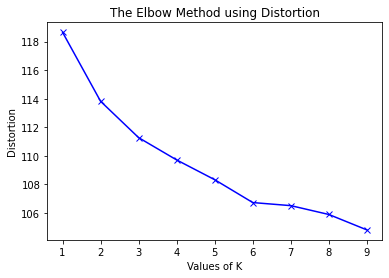

In [121]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

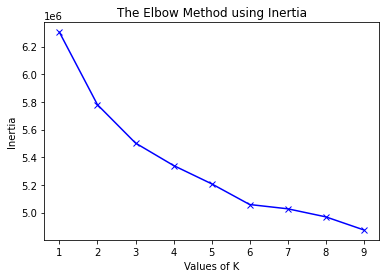

In [122]:
plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

# Clustering

## Using Cosine similarity
Adapted from:
https://stackoverflow.com/questions/63018098/deep-learning-with-python-cosine-similarity

In [28]:
X.shape

(433, 224, 224, 3)

In [30]:
np.expand_dims(X, axis=0).shape



(1, 433, 224, 224, 3)

In [31]:
t_test = np.expand_dims(X[0], axis=0)
t_test.shape

(1, 224, 224, 3)

In [32]:
t1 = np.expand_dims(X[1], axis=0)

In [33]:
t_test = np.concatenate((t_test, t1))
t_test.shape

(2, 224, 224, 3)

In [35]:
np.expand_dims(X, axis=0).shape

(1, 433, 224, 224, 3)

In [147]:
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input, decode_predictions
import numpy as np
import os
import sys

#Calculate similar matrics
def cosine_similarity(ratings):
    sim = ratings.dot(ratings.T)
    if not isinstance(sim,np.ndarray):
        sim = sim.toarray()
    norms = np.array([np.sqrt(np.diagonal(sim))])
    return (sim/norms/norms.T)

def get_features(X):
    #Convert to VGG input format 
    x_test = preprocess_input(X)

    #include_top=False == not getting VGG16 last 3 layers
    model = VGG16(weights = "imagenet", include_top=False)

    #Get features
    features = model.predict(x_test)

    return model, features

    # #Calculate similar metrics
    # features_compress = features.reshape(len(y_test), 7*7*512)
    # sim = cosine_similarity(features_compress)

In [157]:
model_vgg16, features = get_features(X)

In [165]:
features.shape

(433, 7, 7, 512)

input_5 (433, 7, 7, 512)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide


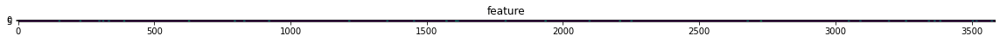

In [166]:
feature_maps = [features]

# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model_vgg16.layers]
for layer_name, feature_map in zip(layer_names, feature_maps):
  print(layer_name, feature_map.shape)
  if len(feature_map.shape) == 4:

    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)

    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))

    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x

    # Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( 'feature' )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [112]:
features.reshape(len(features), -1).shape

(433, 25088)

In [114]:
from sklearn import preprocessing  # to normalise existing X

features_norm = preprocessing.normalize(features.reshape(len(features), -1))

kmeans_features = KMeans(n_clusters=11, random_state=0).fit(features_norm)



In [187]:

def to_groups(group_ids, data):
  groups = []
  for group_id in group_ids:
    groups.append(np.where(data == group_id)[0])
  return groups

group_ids_features, feature_counts = np.unique(kmeans_features.labels_, return_counts=True)
groups_features = to_groups(group_ids_features, kmeans_features.labels_)
groups_features

[array([ 17,  19,  46,  49,  70,  90,  91,  98, 101, 121, 127, 130, 132,
        135, 186, 221, 227, 236, 237, 244, 292, 294, 296, 301, 305, 325,
        347, 367, 376, 383, 386, 407, 410, 423]),
 array([  3,   4,   7,  15,  16,  36,  39,  48,  55,  57,  59,  62,  68,
         69,  75,  77,  86,  92, 102, 111, 113, 116, 118, 119, 122, 125,
        128, 133, 134, 139, 140, 144, 145, 148, 149, 154, 157, 158, 161,
        162, 163, 166, 170, 171, 175, 177, 178, 180, 181, 182, 188, 201,
        206, 207, 208, 213, 216, 217, 219, 228, 235, 241, 243, 247, 248,
        249, 250, 252, 256, 259, 263, 267, 269, 274, 276, 278, 290, 293,
        295, 299, 303, 310, 313, 317, 318, 321, 329, 339, 342, 344, 345,
        346, 353, 360, 362, 365, 370, 385, 388, 389, 390, 395, 401, 404,
        408, 409, 416, 418, 420, 432]),
 array([238, 334, 379]),
 array([ 11,  12, 110, 117, 159, 197, 232, 354, 405, 412, 421, 422]),
 array([  1,   2,   5,   8,  13,  21,  25,  26,  30,  33,  40,  41,  43,
         44,

<BarContainer object of 11 artists>

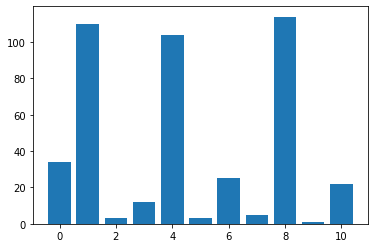

In [116]:
plt.bar(group_ids_features, feature_counts)

In [117]:
print(group_ids_features, feature_counts)

[ 0  1  2  3  4  5  6  7  8  9 10] [ 34 110   3  12 104   3  25   5 114   1  22]


In [188]:
len(X)

433

In [189]:
len(X_test)

87

In [190]:
print(len(X_train), len(X_val), len(X_test))

311 35 87


ValueError: ignored

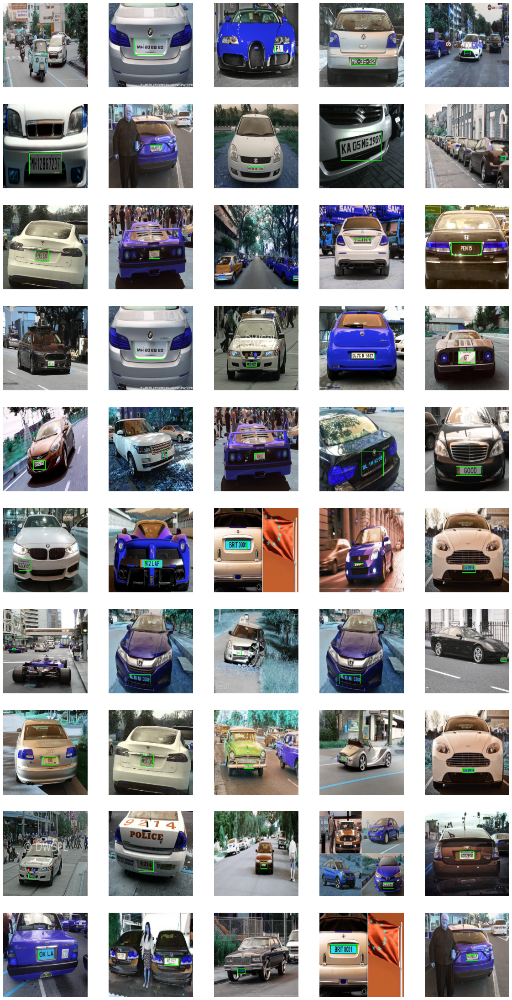

In [191]:
plot_images(X, y, groups_features[8])

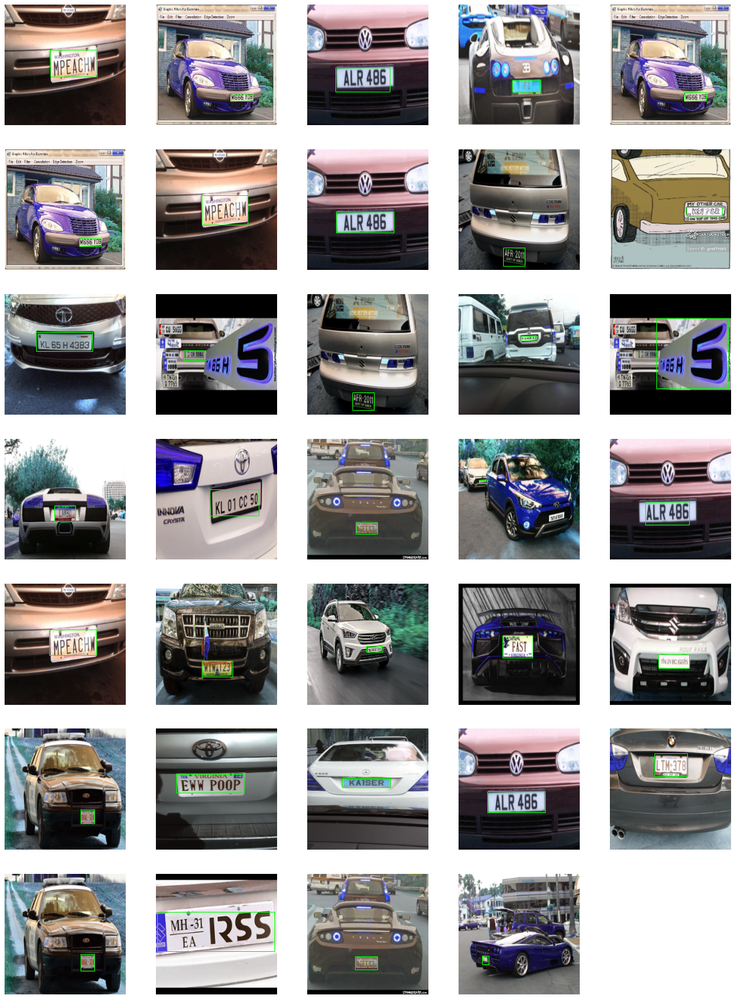

In [185]:
plot_images(X, y, groups_features[0])

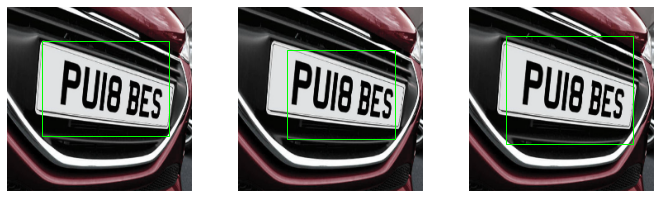

In [118]:
plot_images(X, y, groups_features[2])

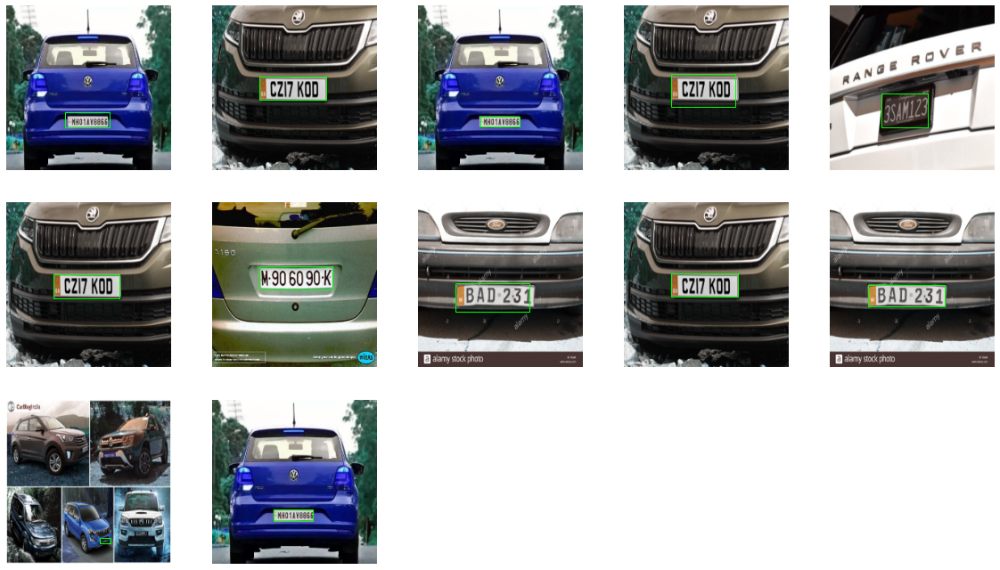

In [119]:
plot_images(X, y, groups_features[3])

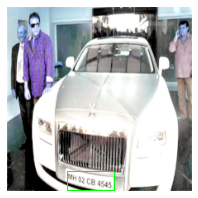

In [120]:
plot_images(X, y, groups_features[9])

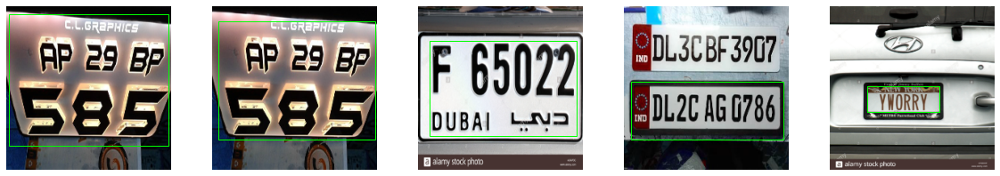

In [121]:
plot_images(X, y, groups_features[7])

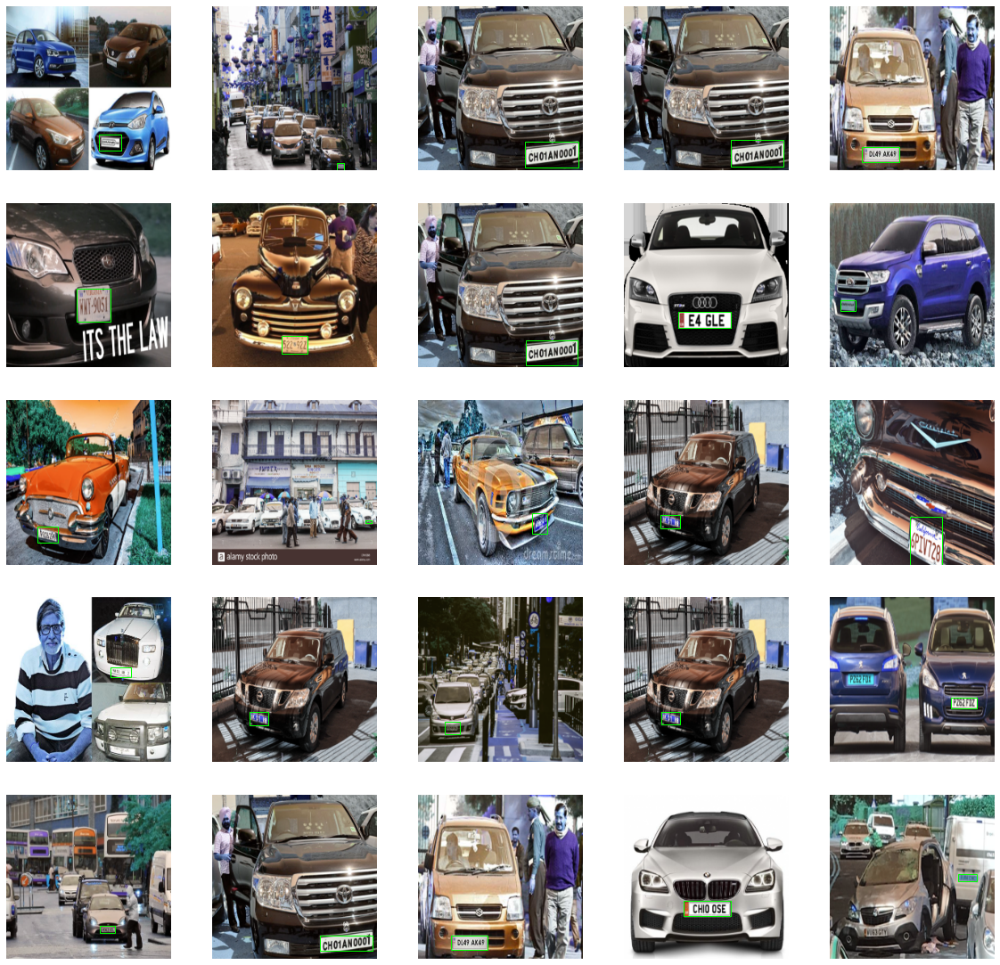

In [122]:
plot_images(X, y, groups_features[6])

In [39]:
features_compress = features.reshape(features.shape[0],
                                     features.shape[1]*features.shape[2]*features.shape[3])
similarities = cosine_similarity(features_compress)

In [43]:
similarities[0].shape

(433,)

In [66]:
topn = 10

In [77]:
topn_sim = np.argsort(-similarities[topn], axis=0)[0:12]
topn_sim

array([297,  61, 368,  10, 222, 361, 118, 303, 278,  58, 264, 253])

In [59]:
def plot_images(X, y, ids):
  fig = plt.figure(figsize=(20,40))
  id = 0
  for i in ids:
      axis = fig.add_subplot(10, 5, id+1)
      id += 1
      plt.axis('off')
      image = X_raw[i]

      rect_ori = create_rect(y[i]*IMAGE_SIZE, (0, 255/255, 0))
      axis.add_patch(rect_ori)
      plt.imshow(image)


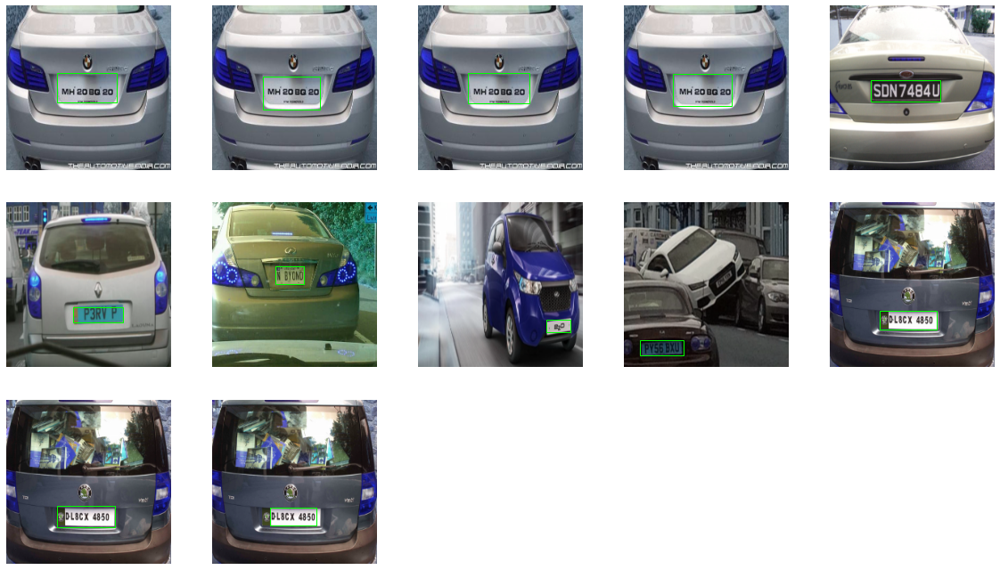

In [78]:
plot_images(X, y, [297, 61, 368, 10, 222, 361, 118, 303, 278,  58, 264, 253])

# Train

## Train with clean data
Everything is clean. y_train and y_val are all clean labels.

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_11 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dense_7 (Dense)              (None, 128)               3211392   
_________________________________________________________________
dense_8 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_9 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_10 (Dense)             (None, 4)                 260       
Total params: 17,951,108
Trainable params: 3,236,420
Non-trainable params: 14,714,688
_________________________________

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with 

mAP:0.91


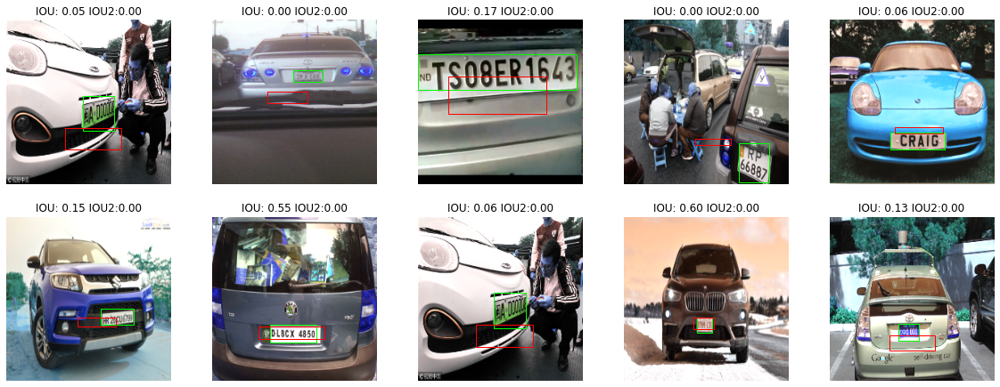

In [ ]:
model_clean_train, y_pred_clean_train, map = run_experiment(X_train, y_train,
                                                            X_val, y_val,
                                                            X_test, y_test,
                                                            50, 32)

In [ ]:
model_clean_train.predict(np.expand_dims(X_test[0], [0]))

array([[0.3544237 , 0.6572129 , 0.6978591 , 0.79280084]], dtype=float32)

In [ ]:
model_clean_train.predict(np.expand_dims(X_test[0], [0]))

array([[0.3544237 , 0.6572129 , 0.6978591 , 0.79280084]], dtype=float32)

In [ ]:
print("mAP: {:.2}".format(map['avg_prec']))

mAP: 0.91


## Train with noisy data

In [ ]:
noise_factor = 10
y_train_noise = noise_annotation(y_train * IMAGE_SIZE, noise_factor)
y_train_noise = np.array(y_train_noise)/IMAGE_SIZE
y_train_noise

model_train_noise = create_model()

model_train_noise, y_pred_train_noise, map_train_noise = run_experiment(model_train_noise,
                                                                        X_train, y_train_noise,
                                                                        X_val, y_val,
                                                                        X_test, y_test, 10, 32)

array([[0.38839286, 0.5625    , 0.84375   , 0.74107143],
       [0.09821429, 0.50892857, 0.45535714, 0.72767857],
       [0.41517857, 0.54017857, 0.49107143, 0.60714286],
       ...,
       [0.32142857, 0.46428571, 0.67857143, 0.72767857],
       [0.45982143, 0.45982143, 0.64285714, 0.54464286],
       [0.35714286, 0.375     , 0.66964286, 0.51339286]])

## Train with probability

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/base_layer.py:2281: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 128)               3211392   
_________________________________________________________________
dense_4 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_5 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_flipout_1 (DenseFlipou (None, 4)                 516       
Total params: 17,951,364
Trainable params: 3,236,676
Non-trainable params: 14,714,688
__________________________________

wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 2/50
10/10 [==============================] - 1s 80ms/step - loss: 2.0943 - accuracy: 0.6458 - val_loss: 2.0853 - val_accuracy: 0.6000


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 3/50
10/10 [==============================] - 1s 81ms/step - loss: 2.0770 - accuracy: 0.6321 - val_loss: 2.0749 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 4/50
10/10 [==============================] - 1s 82ms/step - loss: 2.0634 - accuracy: 0.6806 - val_loss: 2.0636 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 5/50
10/10 [==============================] - 1s 80ms/step - loss: 2.0517 - accuracy: 0.7526 - val_loss: 2.0552 - val_accuracy: 0.7429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 6/50
10/10 [==============================] - 1s 81ms/step - loss: 2.0429 - accuracy: 0.7656 - val_loss: 2.0468 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 7/50
10/10 [==============================] - 1s 82ms/step - loss: 2.0322 - accuracy: 0.8017 - val_loss: 2.0403 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 8/50
10/10 [==============================] - 1s 82ms/step - loss: 2.0239 - accuracy: 0.8035 - val_loss: 2.0311 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 9/50
10/10 [==============================] - 1s 82ms/step - loss: 2.0155 - accuracy: 0.7566 - val_loss: 2.0226 - val_accuracy: 0.7429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 10/50
10/10 [==============================] - 1s 81ms/step - loss: 2.0071 - accuracy: 0.8293 - val_loss: 2.0161 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 11/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9982 - accuracy: 0.7619 - val_loss: 2.0055 - val_accuracy: 0.6857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 12/50
10/10 [==============================] - 1s 82ms/step - loss: 1.9900 - accuracy: 0.8126 - val_loss: 1.9980 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 13/50
10/10 [==============================] - 1s 81ms/step - loss: 1.9823 - accuracy: 0.7825 - val_loss: 1.9928 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 14/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9735 - accuracy: 0.7880 - val_loss: 1.9841 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 15/50
10/10 [==============================] - 1s 83ms/step - loss: 1.9656 - accuracy: 0.7774 - val_loss: 1.9752 - val_accuracy: 0.4857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 16/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9586 - accuracy: 0.7508 - val_loss: 1.9673 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 17/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9495 - accuracy: 0.7960 - val_loss: 1.9586 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 18/50
10/10 [==============================] - 1s 81ms/step - loss: 1.9419 - accuracy: 0.8329 - val_loss: 1.9507 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 19/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9332 - accuracy: 0.8133 - val_loss: 1.9434 - val_accuracy: 0.6000


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 20/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9251 - accuracy: 0.8220 - val_loss: 1.9362 - val_accuracy: 0.6857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 21/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9187 - accuracy: 0.7822 - val_loss: 1.9260 - val_accuracy: 0.6000


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 22/50
10/10 [==============================] - 1s 80ms/step - loss: 1.9105 - accuracy: 0.7764 - val_loss: 1.9178 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 23/50
10/10 [==============================] - 1s 79ms/step - loss: 1.9020 - accuracy: 0.8783 - val_loss: 1.9130 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 24/50
10/10 [==============================] - 1s 79ms/step - loss: 1.8944 - accuracy: 0.7548 - val_loss: 1.9025 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 25/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8865 - accuracy: 0.7935 - val_loss: 1.8950 - val_accuracy: 0.7714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 26/50
10/10 [==============================] - 1s 82ms/step - loss: 1.8780 - accuracy: 0.7847 - val_loss: 1.8897 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 27/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8708 - accuracy: 0.8189 - val_loss: 1.8772 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 28/50
10/10 [==============================] - 1s 82ms/step - loss: 1.8620 - accuracy: 0.8168 - val_loss: 1.8742 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 29/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8552 - accuracy: 0.7692 - val_loss: 1.8614 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 30/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8460 - accuracy: 0.8301 - val_loss: 1.8554 - val_accuracy: 0.7429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 31/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8386 - accuracy: 0.8449 - val_loss: 1.8471 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 32/50
10/10 [==============================] - 1s 81ms/step - loss: 1.8305 - accuracy: 0.8170 - val_loss: 1.8409 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 33/50
10/10 [==============================] - 1s 80ms/step - loss: 1.8225 - accuracy: 0.8485 - val_loss: 1.8331 - val_accuracy: 0.7143


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 34/50
10/10 [==============================] - 1s 79ms/step - loss: 1.8152 - accuracy: 0.7776 - val_loss: 1.8227 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 35/50
10/10 [==============================] - 1s 80ms/step - loss: 1.8070 - accuracy: 0.7967 - val_loss: 1.8139 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 36/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7991 - accuracy: 0.7676 - val_loss: 1.8077 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 37/50
10/10 [==============================] - 1s 81ms/step - loss: 1.7913 - accuracy: 0.8031 - val_loss: 1.8004 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 38/50
10/10 [==============================] - 1s 79ms/step - loss: 1.7837 - accuracy: 0.7743 - val_loss: 1.7932 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 39/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7769 - accuracy: 0.8070 - val_loss: 1.7868 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 40/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7677 - accuracy: 0.8261 - val_loss: 1.7772 - val_accuracy: 0.5429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 41/50
10/10 [==============================] - 1s 79ms/step - loss: 1.7595 - accuracy: 0.8334 - val_loss: 1.7714 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 42/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7519 - accuracy: 0.8361 - val_loss: 1.7620 - val_accuracy: 0.6857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 43/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7440 - accuracy: 0.8309 - val_loss: 1.7529 - val_accuracy: 0.6857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 44/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7357 - accuracy: 0.7978 - val_loss: 1.7481 - val_accuracy: 0.7714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 45/50
10/10 [==============================] - 1s 81ms/step - loss: 1.7286 - accuracy: 0.8041 - val_loss: 1.7391 - val_accuracy: 0.6857


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 46/50
10/10 [==============================] - 1s 81ms/step - loss: 1.7213 - accuracy: 0.7691 - val_loss: 1.7287 - val_accuracy: 0.7429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 47/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7130 - accuracy: 0.7873 - val_loss: 1.7238 - val_accuracy: 0.6571


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 48/50
10/10 [==============================] - 1s 80ms/step - loss: 1.7056 - accuracy: 0.7526 - val_loss: 1.7132 - val_accuracy: 0.7429


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 49/50
10/10 [==============================] - 1s 82ms/step - loss: 1.6978 - accuracy: 0.8103 - val_loss: 1.7068 - val_accuracy: 0.5714


wandb: WARNING No validation_data set, pass a generator to the callback.


Epoch 50/50
10/10 [==============================] - 1s 79ms/step - loss: 1.6905 - accuracy: 0.8488 - val_loss: 1.6997 - val_accuracy: 0.6286


wandb: WARNING No validation_data set, pass a generator to the callback.


Score : 77.01%
100/100 [==============================] - 1s 6ms/step - loss: 1.6903 - accuracy: 0.8046
Test results 
 Loss: 1.690322995185852 
 Accuracy 0.8045976758003235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with 

mAP:0.91


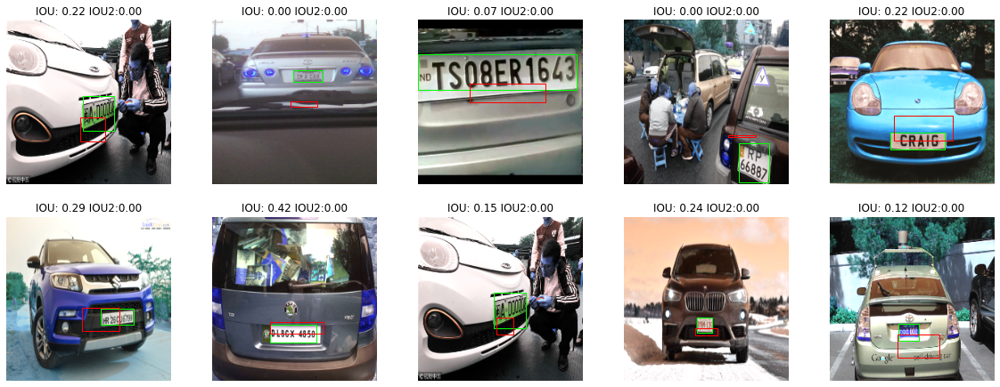

In [175]:
model_prob = create_prob_model()

model_prob, y_pred_prob, map_prob = run_experiment(model_prob,
                                                   X_train, y_train,
                                                   X_val, y_val,
                                                   X_test, y_test, 50, 32)

# Predictions

Need to change 3x2x4 to 2x3x4.

(iterations)x(samples)x(coordinates)

to

(samples)x(iterations)x(coordinates)


In [203]:
def sample_predictions(model, samples, iterations=10):
    predicted = []
    for _ in range(iterations):
        predicted.append(model(samples).numpy())
    predicted = np.array(predicted)
    # predicted = np.concatenate(predicted, axis=1)

    # predicted = np.array([model_prob.predict(np.expand_dims(X_test[1], [0])) for i in range(iterations)])
    # predicted = np.concatenate(predicted, axis=1)
    reshaped = np.array([predicted[:, column] for column in range(0, predicted.shape[1])])

    return reshaped

predicted = sample_predictions(model_prob, X_test)

In [194]:
len(X_val)

35

In [196]:
311+35

346

In [198]:
def create_test_set(ids, X):
  return np.array([X[id] for id in ids])

# group 8 in X_test
group8 = [348,
       352, 358, 361, 363, 364, 368, 375, 377, 378, 384, 392, 396, 398,
       399, 402, 403, 411, 413, 419, 424, 426, 427, 430]


predicted_group8 = sample_predictions(model_prob, create_test_set(group8, X))

IndexError: ignored

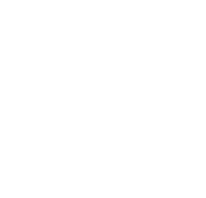

In [208]:


def plot_predictions_by_group(X, y_gt, y_preds, group_ids):
  fig = plt.figure(figsize=(20,40))
  # for i in range(0, 50) :
  for i in range(len(group_ids)):
      axis = fig.add_subplot(10, 5, i+1)
      plt.axis('off')
      image = X[group_ids[i]]
      # image = X[i]

      # rect_ori = create_rect(y_gt[i]*IMAGE_SIZE, (0, 255/255, 0))
      rect_ori = create_rect(y_gt[group_ids[i]]*IMAGE_SIZE, (0, 255/255, 0))
      axis.add_patch(rect_ori)

      for j in range(0, len(y_preds[i])):
        # rect_pred = create_rect(y_preds[i][j]*IMAGE_SIZE, (255/255, 0, 0))
        rect_pred = create_rect(y_preds[group_ids[i]][j]*IMAGE_SIZE, (255/255, 0, 0))
        axis.add_patch(rect_pred)

      # plt.title("mean std: {:0.2f}".format(mean_stds[i]))
      # plt.title("mean std: {:0.2f}".format(mean_stds[group_ids[i]]))
      plt.imshow(image)

plot_predictions_by_group(X_raw, y, predicted_group8, group8)

In [195]:
# 46 = 392 (311 + 35 + 46)
groups_features[8]

array([  6,  10,  14,  20,  23,  24,  27,  28,  31,  32,  34,  35,  38,
        42,  51,  56,  61,  63,  67,  73,  74,  80,  81,  85,  87,  89,
        93,  94,  95,  97,  99, 103, 108, 114, 123, 124, 131, 136, 137,
       138, 143, 146, 153, 167, 173, 176, 187, 189, 194, 195, 202, 209,
       211, 212, 222, 226, 230, 233, 239, 245, 246, 251, 262, 265, 268,
       271, 272, 273, 275, 280, 281, 282, 283, 285, 286, 297, 298, 307,
       312, 314, 315, 319, 320, 322, 324, 331, 337, 338, 340, 341, 348,
       352, 358, 361, 363, 364, 368, 375, 377, 378, 384, 392, 396, 398,
       399, 402, 403, 411, 413, 419, 424, 426, 427, 430])

In [180]:
stds = np.std(predicted, axis=1)
stds.shape


(87, 4)

In [181]:
mean_stds = np.mean(stds, axis=1)

In [182]:
min_id = np.argmin(mean_stds)
max_id = np.argmax(mean_stds)

print("min:", min_id, mean_stds[min_id])
print("max:", max_id, mean_stds[max_id])

[print(f"{id} pred std: ", stds[id], f"mean_std:  {mean_stds[id]})") for id in range(len(X_test))]


min: 27 0.0127531765
max: 58 0.07990325
0 pred std:  [0.02649109 0.02483257 0.0256692  0.02829592] mean_std:  0.026322197169065475)
1 pred std:  [0.02020935 0.02381847 0.01650975 0.01834377] mean_std:  0.01972033455967903)
2 pred std:  [0.0267413  0.02595626 0.03774801 0.05368031] mean_std:  0.03603147342801094)
3 pred std:  [0.04146837 0.06938463 0.04477659 0.04237516] mean_std:  0.04950118809938431)
4 pred std:  [0.03246741 0.03163937 0.02605315 0.03108704] mean_std:  0.030311740934848785)
5 pred std:  [0.02635871 0.01528843 0.02515064 0.02134064] mean_std:  0.022034602239727974)
6 pred std:  [0.02645713 0.04154085 0.04681125 0.04664614] mean_std:  0.04036384075880051)
7 pred std:  [0.03606072 0.03333293 0.03190736 0.02238531] mean_std:  0.030921582132577896)
8 pred std:  [0.0295339  0.03115042 0.02140934 0.03207741] mean_std:  0.028542768210172653)
9 pred std:  [0.0432976  0.04392257 0.03788557 0.04075036] mean_std:  0.04146402329206467)
10 pred std:  [0.02146388 0.03046269 0.027938

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


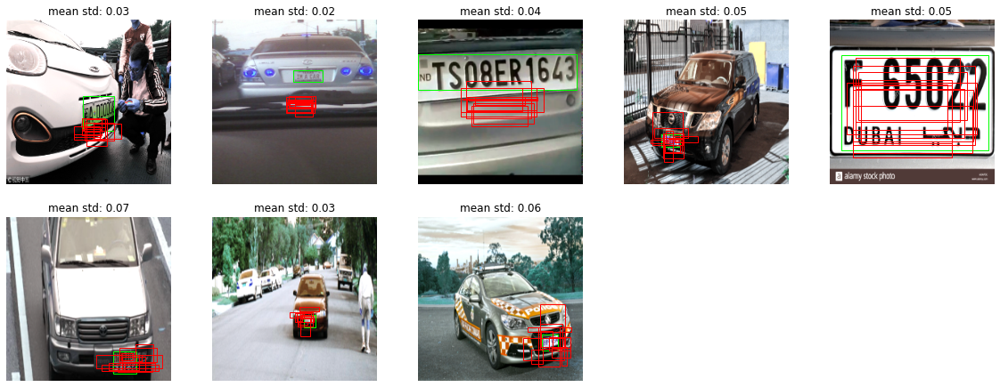

In [204]:
sample_ids = [0, 1, 2, 20, 30, 40, 68, 46]

def plot_predictions(X, y_gt, y_preds):
  fig = plt.figure(figsize=(20,40))
  # for i in range(0, 50) :
  for i in range(len(sample_ids)):
      axis = fig.add_subplot(10, 5, i+1)
      plt.axis('off')
      image = X[sample_ids[i]]
      # image = X[i]

      # rect_ori = create_rect(y_gt[i]*IMAGE_SIZE, (0, 255/255, 0))
      rect_ori = create_rect(y_gt[sample_ids[i]]*IMAGE_SIZE, (0, 255/255, 0))
      axis.add_patch(rect_ori)

      for j in range(0, len(y_preds[i])):
        # rect_pred = create_rect(y_preds[i][j]*IMAGE_SIZE, (255/255, 0, 0))
        rect_pred = create_rect(y_preds[sample_ids[i]][j]*IMAGE_SIZE, (255/255, 0, 0))
        axis.add_patch(rect_pred)

      # plt.title("mean std: {:0.2f}".format(mean_stds[i]))
      plt.title("mean std: {:0.2f}".format(mean_stds[sample_ids[i]]))
      plt.imshow(image)

plot_predictions(X_test, y_test, predicted)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


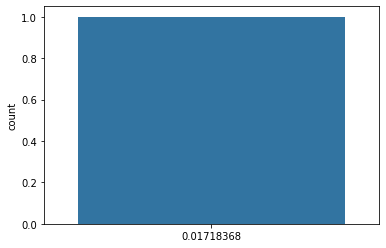

In [ ]:
import seaborn as sns

sns.countplot(preds0)

In [ ]:
def calculate_area(bbox):
  x_tl, y_tl, x_br, y_br = bbox
  return (x_br - x_tl)*(y_br - y_tl)

In [ ]:
len(sample_preds)

1000

In [ ]:
sample_preds[0]

array([[0.5533793 , 0.40564913, 0.7581168 , 0.65057504]], dtype=float32)

In [ ]:
pred_areas = [calculate_area(bbox[0]) for bbox in sample_preds]

(array([0.03613202, 0.07226405, 0.20474816, 5.16687949, 5.50411171,
        0.7346845 , 0.18066012, 0.1204401 , 0.        , 0.02408802]),
 array([-0.31531197, -0.23228313, -0.14925429, -0.06622546,  0.01680337,
         0.09983221,  0.18286105,  0.26588988,  0.3489187 ,  0.43194756,
         0.5149764 ], dtype=float32),
 <a list of 1 Patch objects>)

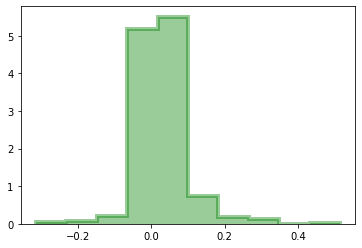

In [ ]:
plt.hist(pred_areas, color='g', alpha=0.4, histtype='step', label='plates', fill=True, linewidth=4, density=True)


(array([ 0.       ,  0.       ,  0.       ,  0.       ,  0.       ,
        10.0000006,  0.       ,  0.       ,  0.       ,  0.       ]),
 array([-0.48951897, -0.38951895, -0.28951895, -0.18951896, -0.08951896,
         0.01048104,  0.11048104,  0.21048105,  0.31048104,  0.41048104,
         0.51048106], dtype=float32),
 <a list of 1 Patch objects>)

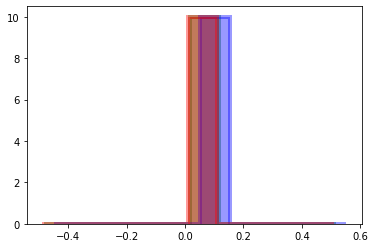

In [ ]:
def get_pred_areas(x):
  sample_preds = [model_prob_train.predict(np.expand_dims(x, [0])) for i in range(100)]
  sample_preds = fix_predictions(sample_preds[0])
  pred_areas = [calculate_area(bbox) for bbox in sample_preds]
  return pred_areas

preds0 = get_pred_areas(X_test[0])
preds1 = get_pred_areas(X_test[1])
preds2 = get_pred_areas(X_test[2])

plt.hist(preds0, color='g', alpha=0.4, histtype='step', label='0', fill=True, linewidth=4, density=True)
plt.hist(preds1, color='b', alpha=0.4, histtype='step', label='1', fill=True, linewidth=4, density=True)
plt.hist(preds2, color='r', alpha=0.4, histtype='step', label='2', fill=True, linewidth=4, density=True)

# Bayesian
To start with, the following code is borrowed from 
https://keras.io/examples/keras_recipes/bayesian_neural_networks/ with some modifications.


## Priors and posteriors



In [ ]:
# Define the prior weight distribution as Normal of mean=0 and stddev=1.
# Note that, in this example, the we prior distribution is not trainable,
# as we fix its parameters.
def prior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    prior_model = keras.Sequential(
        [
            tfp.layers.DistributionLambda(
                lambda t: tfp.distributions.MultivariateNormalDiag(
                    loc=tf.zeros(n), scale_diag=tf.ones(n)
                )
            )
        ]
    )
    return prior_model


# Define variational posterior weight distribution as multivariate Gaussian.
# Note that the learnable parameters for this distribution are the means,
# variances, and covariances.
def posterior(kernel_size, bias_size, dtype=None):
    n = kernel_size + bias_size
    posterior_model = keras.Sequential(
        [
            tfp.layers.VariableLayer(
                tfp.layers.MultivariateNormalTriL.params_size(n), dtype=dtype
            ),
            tfp.layers.MultivariateNormalTriL(n),
        ]
    )
    return posterior_model

## Build the model

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_probability as tfp
tfd = tfp.distributions

train_size = X_test.shape[0]

# Create the model
model = Sequential()
model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
model.add(Flatten())
model.add(Dense(128, activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=128,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=64,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="relu"))
model.add(tfp.layers.DenseVariational(
    units=4,
    make_prior_fn=prior,
    make_posterior_fn=posterior,
    kl_weight=1/train_size,
    activation="sigmoid"))

model.layers[-6].trainable = False

model.summary()

Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_4 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_7 (Dense)              (None, 128)               3211392   
_________________________________________________________________
dense_variational (DenseVari (None, 128)               136347840 
_________________________________________________________________
dense_variational_1 (DenseVa (None, 64)                34093152  
_________________________________________________________________
dense_variational_2 (DenseVa (None, 4)                 34190     
Total params: 188,401,262
Trainab

In [ ]:
import datetime
import tensorflow as tf

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])

In [ ]:
model.save('my_model.h5', overwrite=True) 

In [ ]:
# Test
scores = model.evaluate(X_test, y_test, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

Score : 43.68%


In [ ]:
examples = X_test

def compute_predictions(model, iterations=100):
    predicted = []
    for _ in range(iterations):
        predicted.append(model(examples).numpy())
    predicted = np.concatenate(predicted, axis=1)

    prediction_mean = np.mean(predicted, axis=1).tolist()
    prediction_min = np.min(predicted, axis=1).tolist()
    prediction_max = np.max(predicted, axis=1).tolist()
    prediction_range = (np.max(predicted, axis=1) - np.min(predicted, axis=1)).tolist()

    for idx in range(sample):
        print(
            f"Predictions mean: {round(prediction_mean[idx], 2)}, "
            f"min: {round(prediction_min[idx], 2)}, "
            f"max: {round(prediction_max[idx], 2)}, "
            f"range: {round(prediction_range[idx], 2)} - "
            f"Actual: {targets[idx]}"
        )

compute_predictions(model)

ResourceExhaustedError: ignored

In [ ]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()

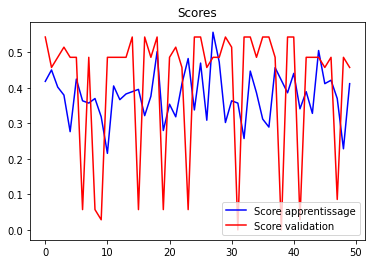

In [ ]:
plot_scores(train)

In [ ]:
%load_ext tensorboard

%tensorboard --logdir logs/fit

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 480), started 0:48:54 ago. (Use '!kill 480' to kill it.)

<IPython.core.display.Javascript object>

# Reference
- [TensorFlow Probability regression tutorial](https://colab.research.google.com/github/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Probabilistic_Layers_Regression.ipynb)